In [3]:
from IPython.display import clear_output as cls
!pip install tf_explain
cls()

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Common
import os
import keras
import numpy as np
from glob import glob
from tqdm import tqdm
import tensorflow as tf

# Data
import tensorflow.data as tfd
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visualization
import matplotlib.pyplot as plt

# Model
from keras.layers import ReLU
from keras.layers import Input
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.models import Sequential, Model
from keras.layers import BatchNormalization

# Pretrained Model
from tensorflow.keras.applications import ResNet50

# Callbacks
from keras.callbacks import Callback, ModelCheckpoint

# Model Visualization
from tensorflow.keras.utils import plot_model

# Model Explaination
from tf_explain.core.grad_cam import GradCAM


In [5]:
# Specify Root Path
image_path = '/content/drive/MyDrive/Water Bodies Dataset/Images/'

In [6]:
def load_image(path, IMAGE_SIZE=256):

    # Load Image
    image = load_img(path)

    # Convert to Array
    image = img_to_array(image)

    # Resize
    image = tfi.resize(image, (IMAGE_SIZE, IMAGE_SIZE))

    # Convert to float32
    image = tf.cast(image, tf.float32)

    # Standardization
    image = image/255.

    return image

def load_images(paths, IMAGE_SIZE=256):

    # Create Space
    images = np.zeros(shape=(len(paths), IMAGE_SIZE, IMAGE_SIZE, 3))

    # Iterate Paths
    for i, path in tqdm(enumerate(paths), desc="Loading"):

        # Load Image
        images[i] = load_image(path, IMAGE_SIZE=IMAGE_SIZE)

    return images

def load_data(root_path, trim=None, IMAGE_SIZE=256, BATCH_SIZE=8, files=False):

    # Collect Image Paths
    image_paths = glob(root_path + "*.jpg")

    # Trim if needed
    if trim is not None:
        image_paths = image_paths[trim[0]:trim[1]]

    # Update mask paths
    mask_paths  = []
    for path in image_paths:
        mask_path = path.replace("Images", "Masks")
        mask_paths.append(mask_path)

    # Load Data
    images, masks = load_images(image_paths, IMAGE_SIZE=IMAGE_SIZE), load_images(mask_paths, IMAGE_SIZE=IMAGE_SIZE)

    # Convert To data
    data = tfd.Dataset.from_tensor_slices((images, masks))
    data = data.batch(BATCH_SIZE, drop_remainder=True)
    data = data.shuffle(1000).prefetch(tfd.AUTOTUNE)
    if files:
        return data, images, masks
    return data

In [7]:
train_ds = load_data(image_path, trim=[100,600], IMAGE_SIZE=128) # in order to use more images, I will have to reduce the image size. Due to memory constraints.

Loading: 500it [01:06,  7.49it/s]
Loading: 500it [05:21,  1.56it/s]


In [8]:
valid_ds, val_images, val_masks = load_data(image_path, trim=[0,100], files=True, IMAGE_SIZE=128)

Loading: 100it [00:18,  5.36it/s]
Loading: 100it [01:00,  1.64it/s]


In [9]:
def show_images(data, model=None, explain=False, n_images=6, SIZE=(25,10)):

    # Plot Configurations
    if model is not None:
        if explain:
            n_cols = 5
        else:
            n_cols = 4
    else:
        n_cols = 3

    # Iterate through data
    for plot_no in range(1, n_images+1):
        for index, (images, masks) in enumerate(iter(data)):

            # Select Items
            id = np.random.randint(len(images))
            image, mask = images[id], masks[id]

            if model is not None:

                if explain:

                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]

                    # Grad CAM
                    cam = GradCAM()
                    cam = cam.explain(
                        validation_data=(val_images[id][np.newaxis,...], val_masks[id]),
                        model=model,
                        class_index=1,
                        layer_name="Top-ConvBlock-2",
                        image_weight=0.5
                    )

                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask)
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask)
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Mixed
                    plt.subplot(1, n_cols, 5)
                    plt.imshow(cam)
                    plt.axis('off')
                    plt.title("Grad CAM")

                    # Show Image
                    plt.show()

                else:
                    # Make Prediction
                    pred_mask = model.predict(image[np.newaxis, ...])[0]

                    # Figure
                    plt.figure(figsize=SIZE)

                    # Original Image
                    plt.subplot(1, n_cols, 1)
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title("Original Image")

                    # Original Mask
                    plt.subplot(1, n_cols, 2)
                    plt.imshow(mask)
                    plt.axis('off')
                    plt.title('Original Mask')

                    # Predicted Mask
                    plt.subplot(1, n_cols, 3)
                    plt.imshow(pred_mask)
                    plt.axis('off')
                    plt.title("Predicted Mask")

                    # Mixed
                    plt.subplot(1, n_cols, 4)
                    plt.imshow(image)
                    plt.imshow(pred_mask, alpha=0.4)
                    plt.axis('off')
                    plt.title("Overlaped Prediction")

                    # Show Image
                    plt.show()

            else:

                # Figure
                plt.figure(figsize=SIZE)

                # Original Image
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                # Original Mask
                plt.subplot(1, n_cols, 2)
                plt.imshow(mask)
                plt.axis('off')
                plt.title('Original Mask')

                # Mixed
                plt.subplot(1, n_cols, 3)
                plt.imshow(image)
                plt.imshow(mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Image")

                # Show Image
                plt.show()

            # Break Loop
            break

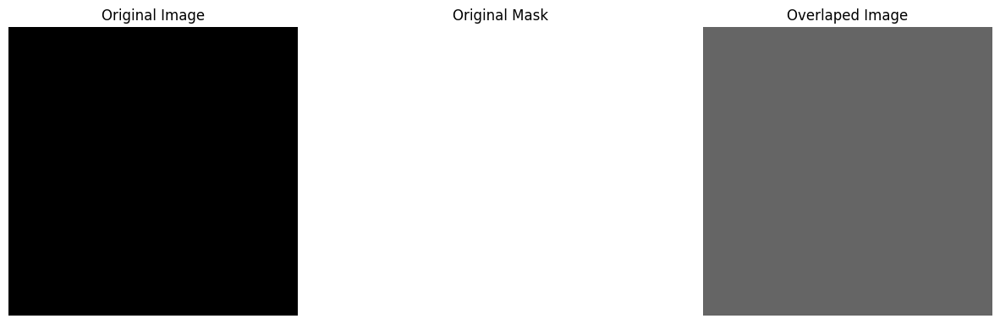

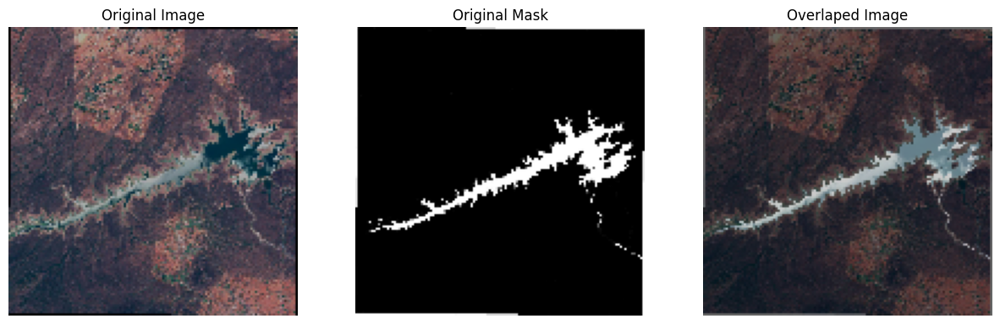

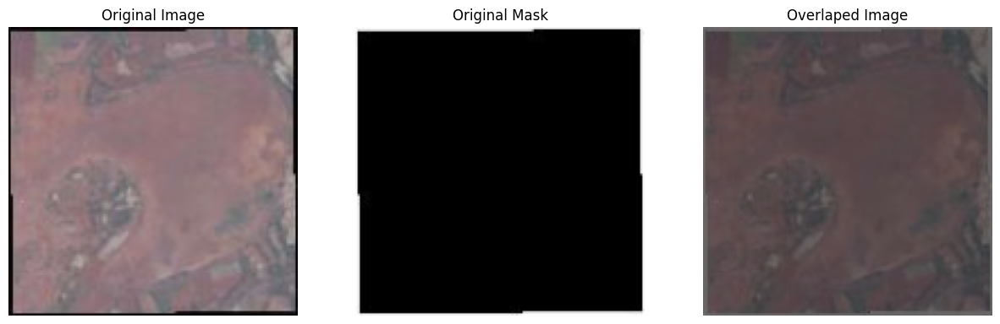

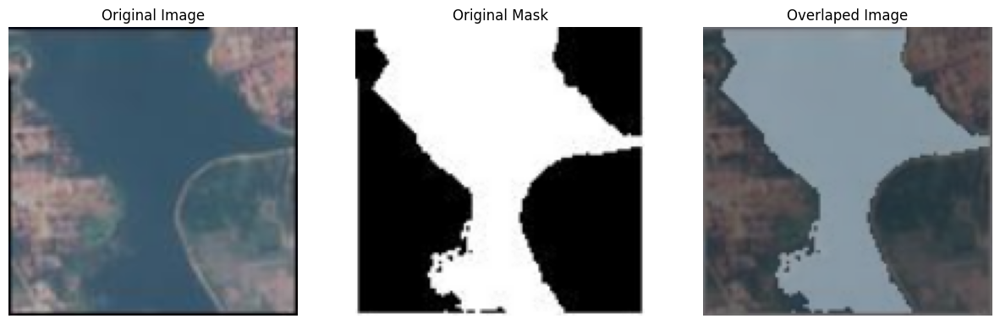

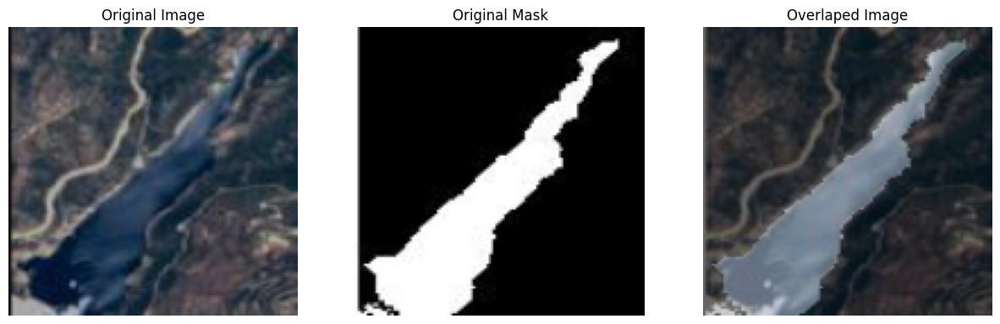

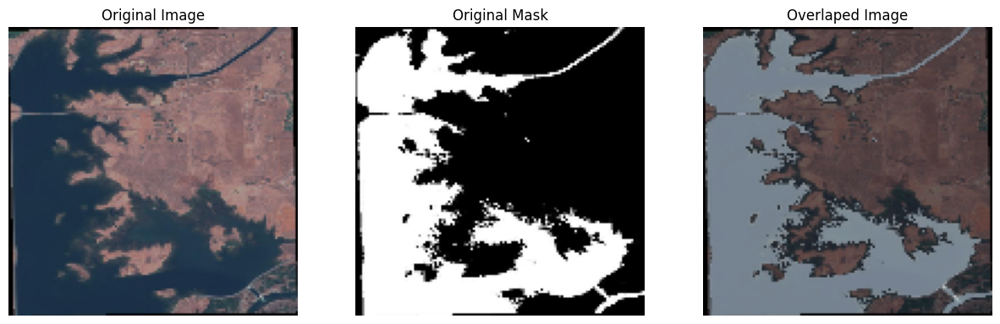

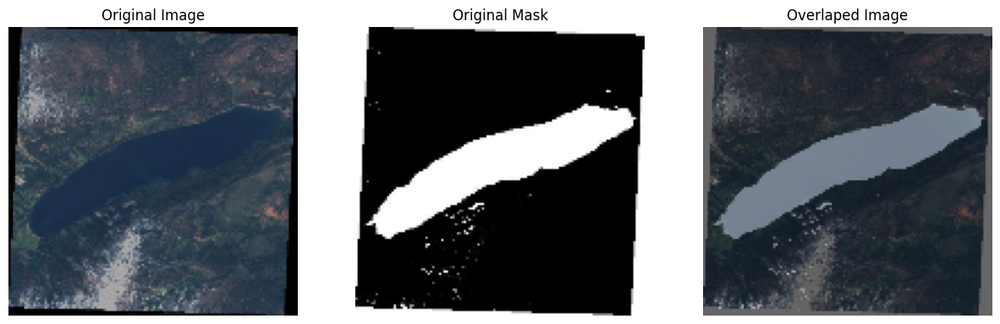

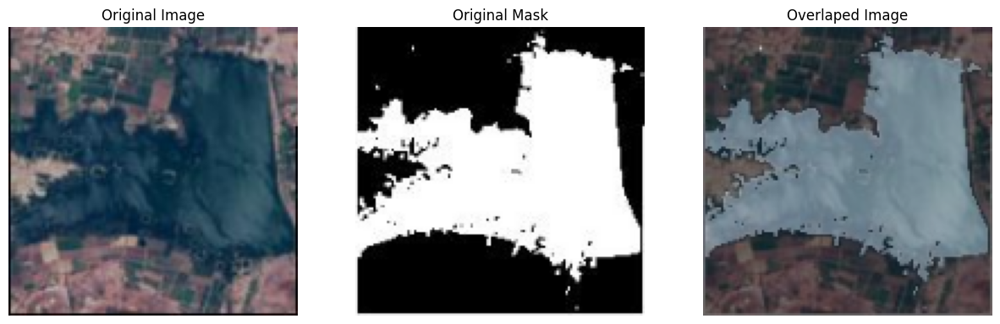

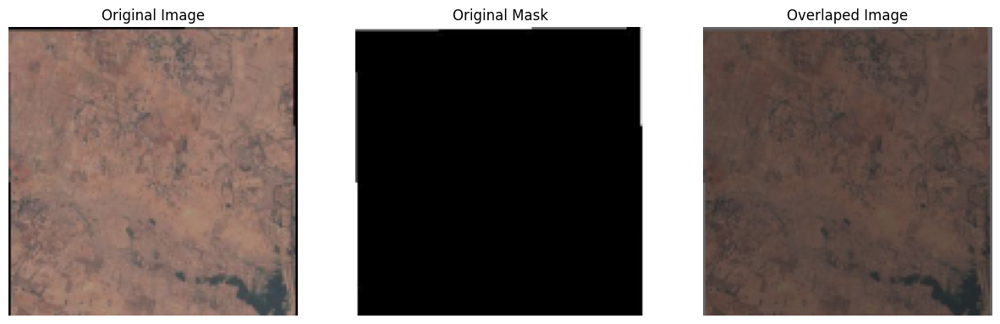

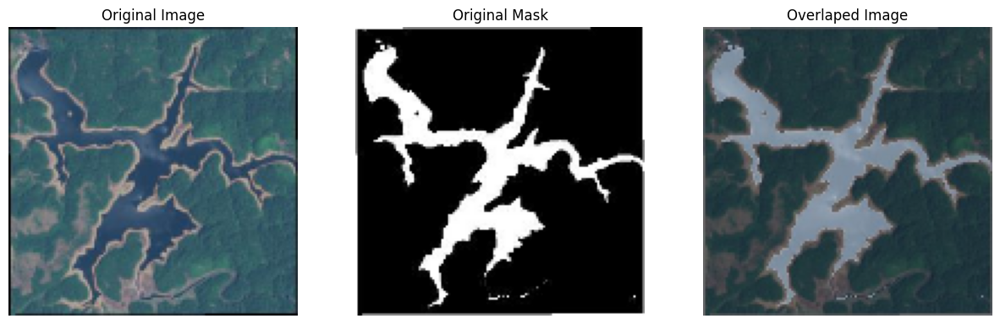

In [ ]:
show_images(data=train_ds, n_images=10, SIZE=(15,5))

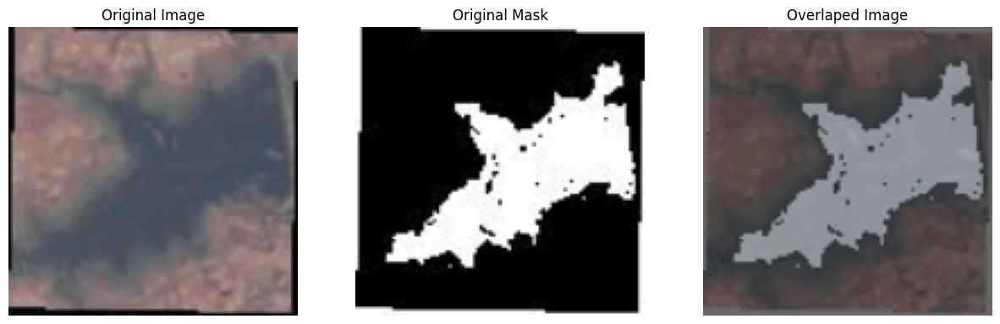

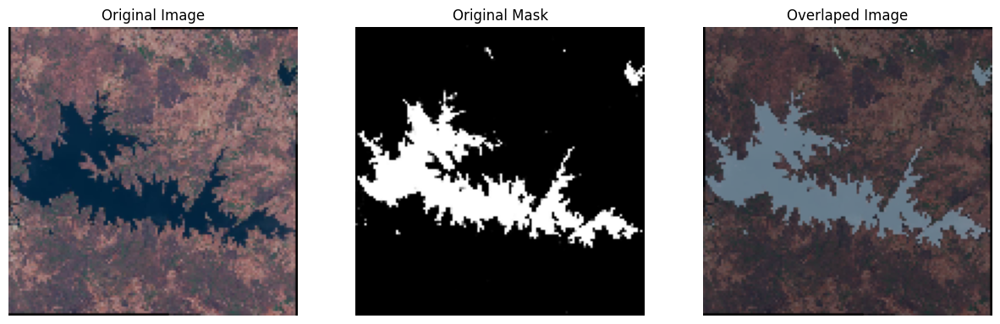

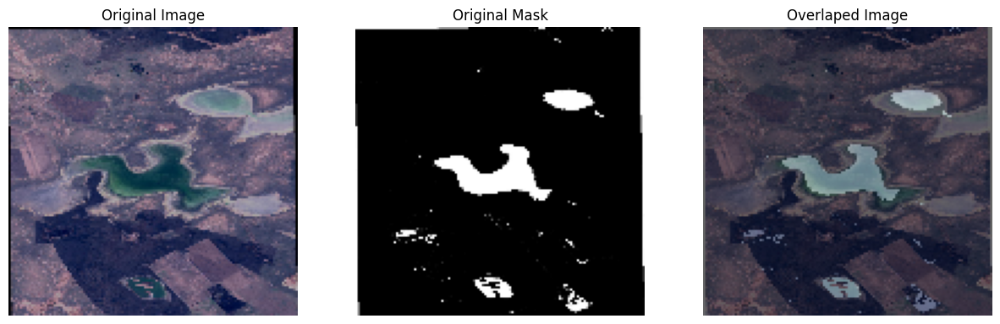

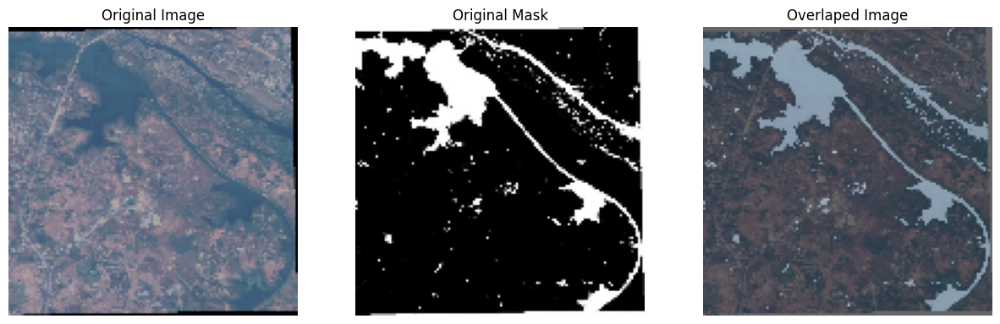

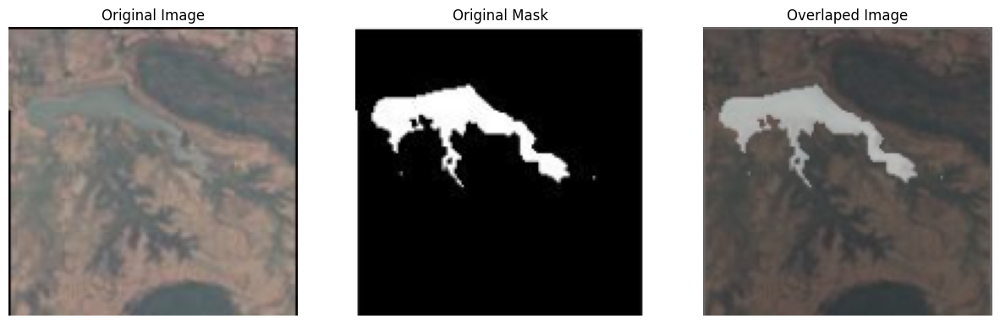

In [ ]:
show_images(data=valid_ds, n_images=5, SIZE=(15,8))

In [10]:
class ConvBlock(Layer):

    def __init__(self, filters=256, kernel_size=3, dilation_rate=1, **kwargs):
        super(ConvBlock, self).__init__(**kwargs)

        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', dilation_rate=dilation_rate, use_bias=False, kernel_initializer='he_normal'),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate,
        }

In [11]:
def AtrousSpatialPyramidPooling(X):
    B, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-AvgPool")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[2]), name="ASPP-ImagePool-UpSample")(image_pool)

    # Atrous Oprtations
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-CB-1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-CB-6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-CB-12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-CB-18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Combine")([image_pool, conv_1, conv_6, conv_12, conv_18])
    processed = ConvBlock(kernel_size=1, name="ASPP-Net")(combined)

    # Final Output
    return processed

In [12]:
# PARAM
LR = 1e-3
IMAGE_SIZE = 128

# Input
InputL = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Base Mode
resnet50 = ResNet50(include_top=False, weights='imagenet', input_tensor=InputL)

# ASPP Phase
DCNN = resnet50.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]), name="AtrousSpatial")(ASPP)

# LLF Phase
LLF = resnet50.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combined
combined = Concatenate(axis=-1, name="Combine-LLF-ASPP")([ASPP, LLF])
features = ConvBlock(name="Top-ConvBlock-1")(combined)
features = ConvBlock(name="Top-ConvBlock-2")(features)
upsample = UpSampling2D(size=(IMAGE_SIZE//features.shape[1], IMAGE_SIZE//features.shape[1]), interpolation='bilinear', name="Top-UpSample")(features)

# Output Mask
PredMask = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(upsample)

# DeelLabV3+ Model
model = Model(InputL, PredMask, name="DeepLabV3-Plus")
model.summary()

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Model: "DeepLabV3-Plus"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 134, 134,  │          0 │ InputLayer[0][0]  │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 64, 64,    │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 64, 64,    │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 64, 64,    │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 66, 66,    │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 32, 32,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 32, 32,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 32, 32,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 32, 32,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 32, 32,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 32, 32,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 32, 32,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 32, 32,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 32, 32,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 32, 32,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 32, 32,    │      1,024 │ conv2_block1_3_c

 Total params: 11,858,752 (45.24 MB)

 Trainable params: 11,826,016 (45.11 MB)

 Non-trainable params: 32,736 (127.88 KB)

In [13]:
plot_model(model, "DeepLabV3+.png", show_shapes=True, dpi=96)

Epoch 1/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.5562

62/62 ━━━━━━━━━━━━━━━━━━━━ 73s 192ms/step - loss: 0.5549 - val_loss: 14.2115
Epoch 2/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.3679

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 107ms/step - loss: 0.3678 - val_loss: 12.5837
Epoch 3/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.3249

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - loss: 0.3247 - val_loss: 6.4196
Epoch 4/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 0.3017

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 108ms/step - loss: 0.3017 - val_loss: 4.5419
Epoch 5/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.2857

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['InputLayer']]
Received: inputs=Tensor(shape=(1, 128, 128, 3))
  warnings.warn(msg)


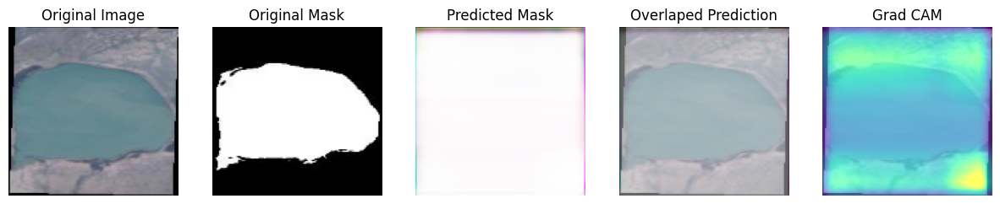

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


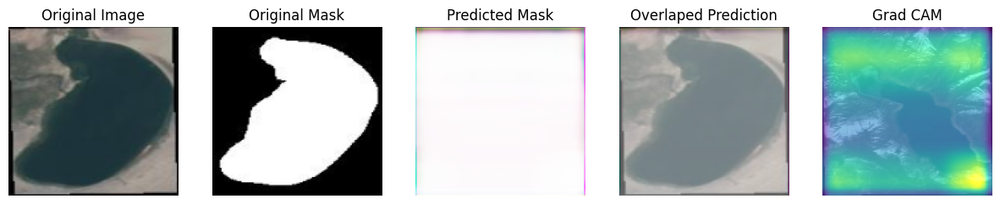

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


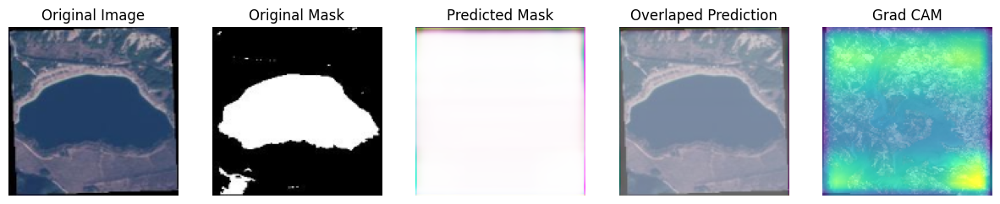

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


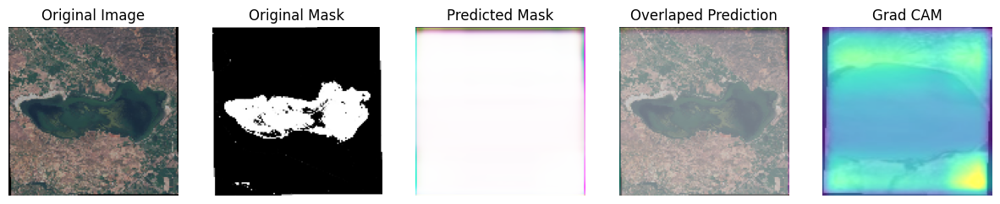

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


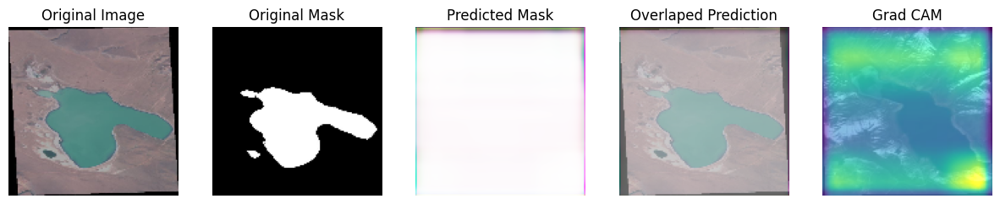

62/62 ━━━━━━━━━━━━━━━━━━━━ 35s 511ms/step - loss: 0.2860 - val_loss: 3.3087
Epoch 6/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.2936

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - loss: 0.2936 - val_loss: 3.4253
Epoch 7/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.2552

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 113ms/step - loss: 0.2549 - val_loss: 0.5999
Epoch 8/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.2688

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 116ms/step - loss: 0.2687 - val_loss: 4.5444
Epoch 9/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.2431

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - loss: 0.2433 - val_loss: 0.9384
Epoch 10/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.2080

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


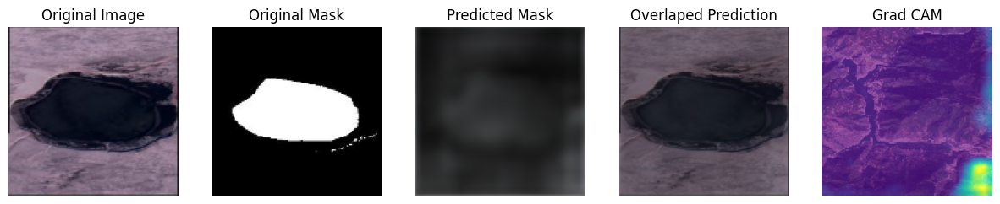

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


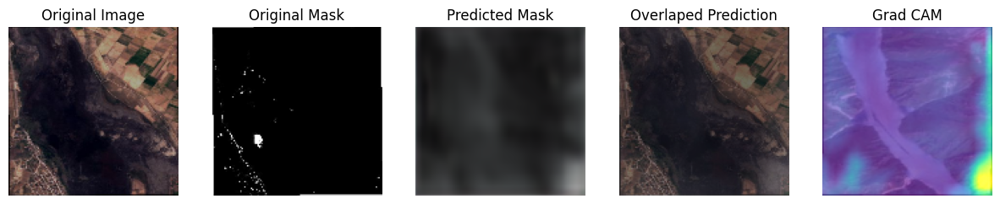

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


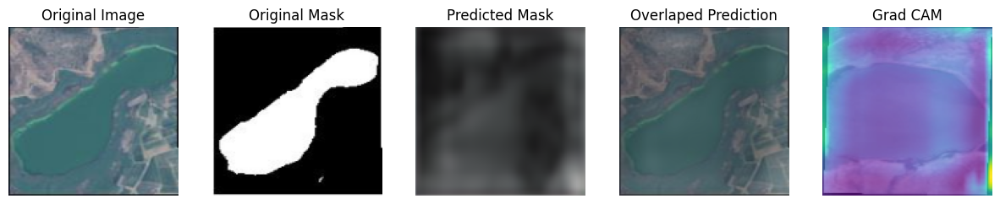

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


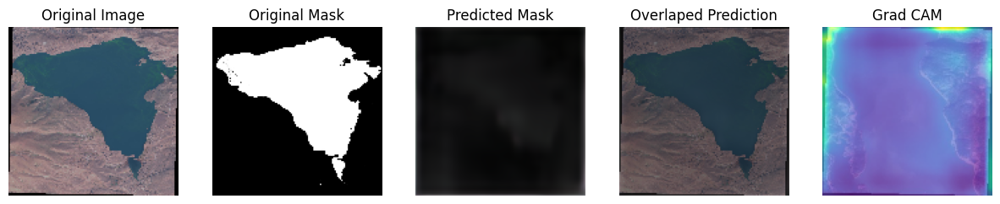

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


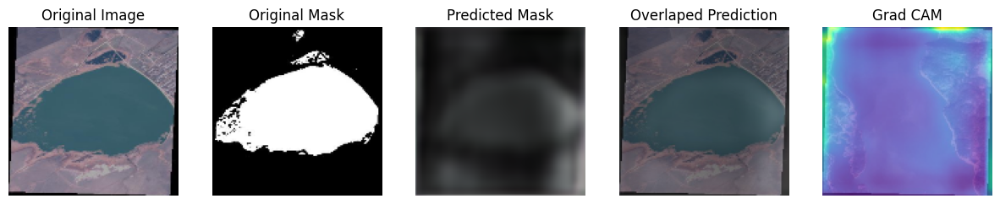

62/62 ━━━━━━━━━━━━━━━━━━━━ 17s 216ms/step - loss: 0.2080 - val_loss: 0.6753
Epoch 11/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.1934

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - loss: 0.1934 - val_loss: 0.5755
Epoch 12/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - loss: 0.1688

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 109ms/step - loss: 0.1689 - val_loss: 0.8131
Epoch 13/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.1734

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - loss: 0.1734 - val_loss: 0.4969
Epoch 14/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1533

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - loss: 0.1534 - val_loss: 0.6367
Epoch 15/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.1409

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


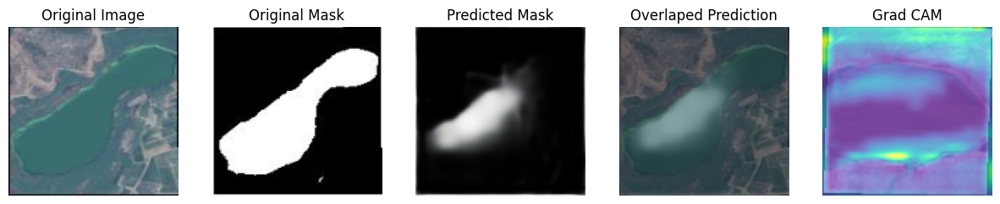

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


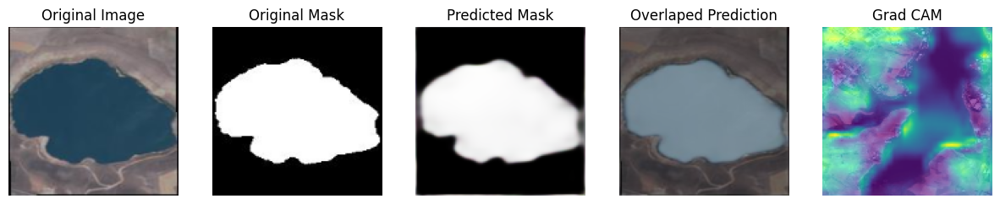

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


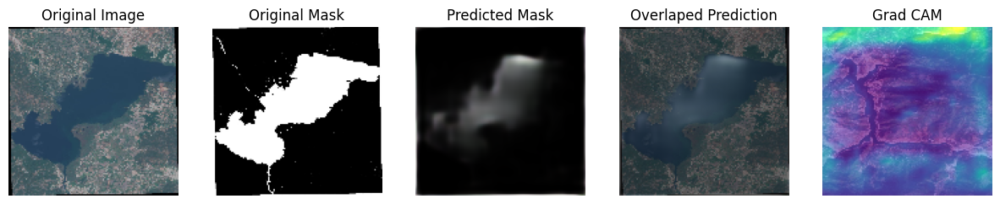

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


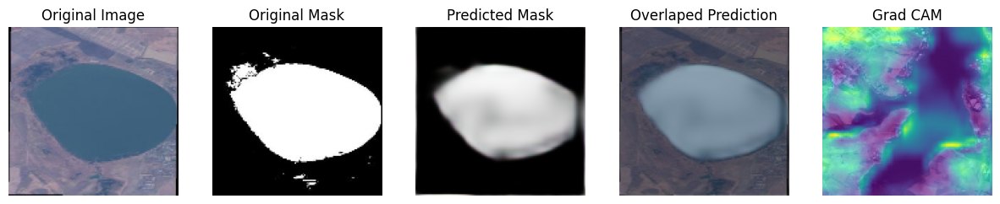

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


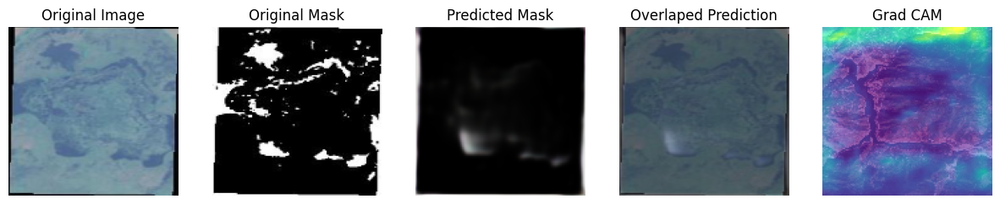

62/62 ━━━━━━━━━━━━━━━━━━━━ 15s 198ms/step - loss: 0.1409 - val_loss: 0.6346
Epoch 16/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.1394

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 115ms/step - loss: 0.1394 - val_loss: 0.4120
Epoch 17/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.1305

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - loss: 0.1304 - val_loss: 0.3759
Epoch 18/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1205

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 111ms/step - loss: 0.1204 - val_loss: 0.3310
Epoch 19/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.1034

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 110ms/step - loss: 0.1035 - val_loss: 0.2943
Epoch 20/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1030

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


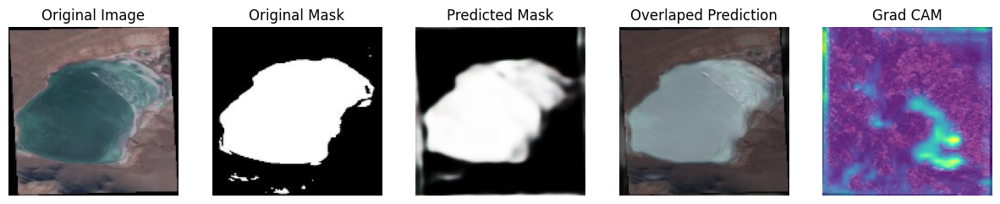

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


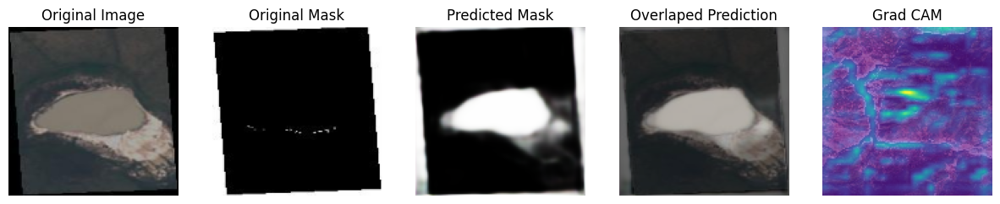

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


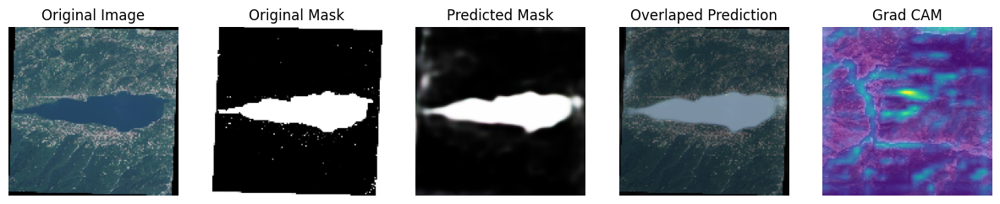

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


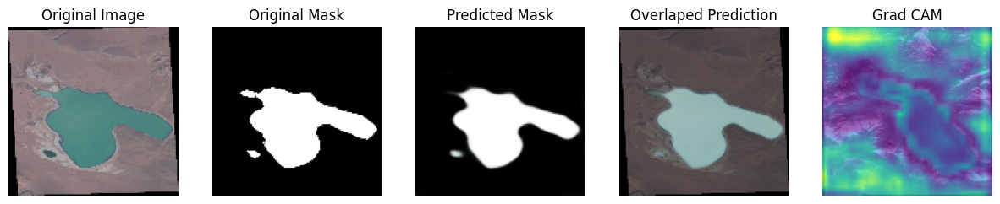

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


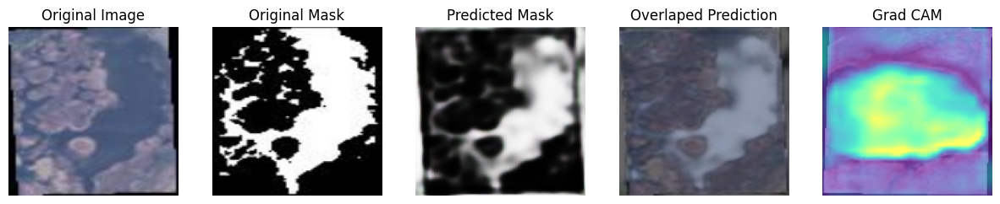

62/62 ━━━━━━━━━━━━━━━━━━━━ 12s 201ms/step - loss: 0.1030 - val_loss: 0.2665
Epoch 21/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.1010

62/62 ━━━━━━━━━━━━━━━━━━━━ 15s 111ms/step - loss: 0.1010 - val_loss: 0.2971
Epoch 22/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1015

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - loss: 0.1014 - val_loss: 0.2919
Epoch 23/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.0954

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 112ms/step - loss: 0.0953 - val_loss: 0.2867
Epoch 24/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.0859

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 112ms/step - loss: 0.0859 - val_loss: 0.3047
Epoch 25/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.0871

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


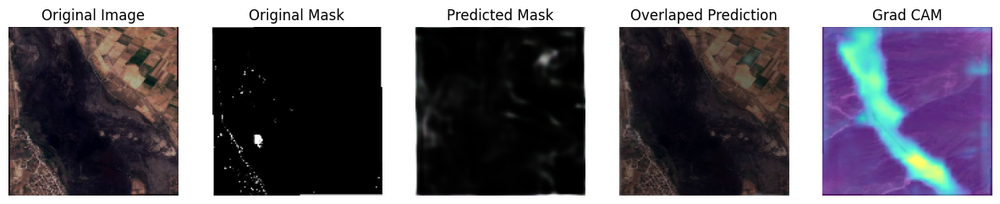

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


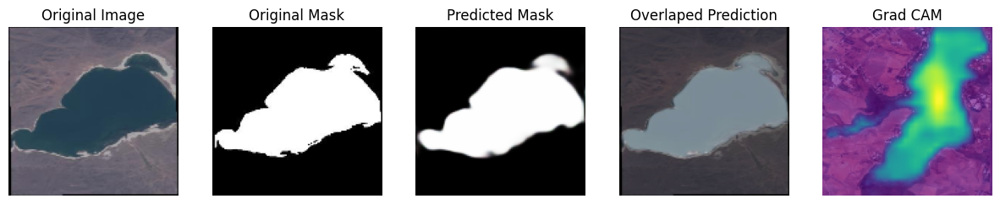

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


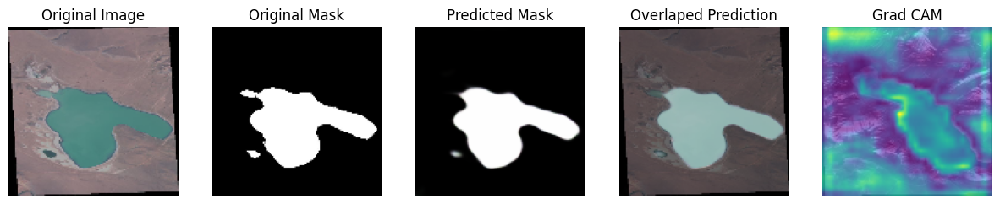

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


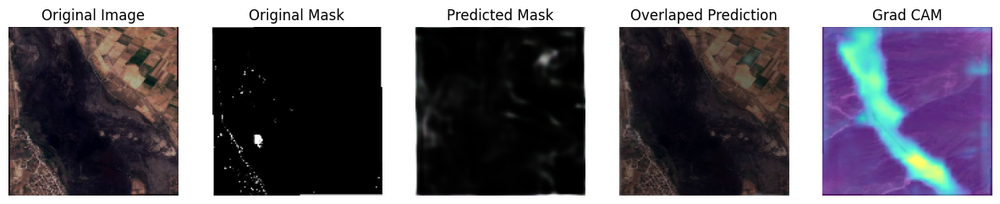

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


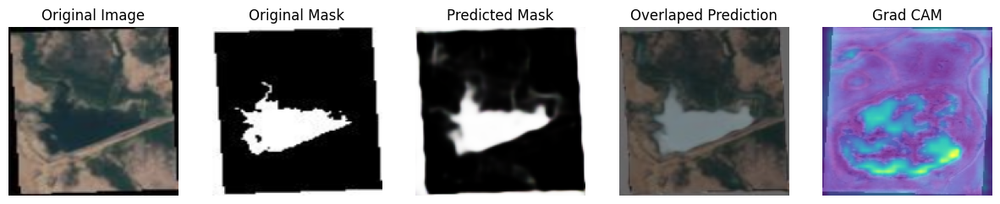

62/62 ━━━━━━━━━━━━━━━━━━━━ 11s 185ms/step - loss: 0.0871 - val_loss: 0.2824
Epoch 26/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0868

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - loss: 0.0868 - val_loss: 0.2959
Epoch 27/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0840

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 111ms/step - loss: 0.0840 - val_loss: 0.3221
Epoch 28/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0847

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 117ms/step - loss: 0.0846 - val_loss: 0.3245
Epoch 29/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.0804

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 112ms/step - loss: 0.0804 - val_loss: 0.3073
Epoch 30/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.0815

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


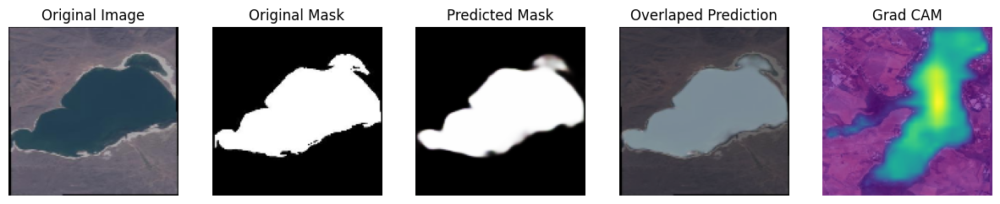

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


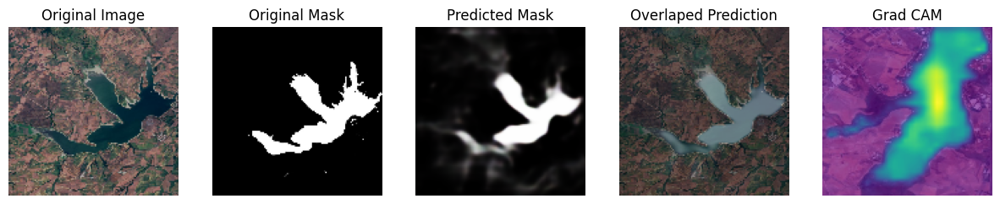

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


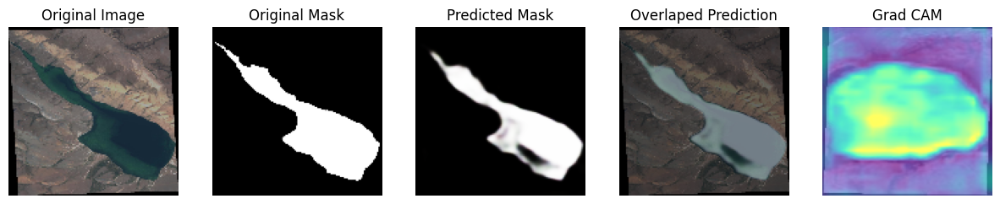

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


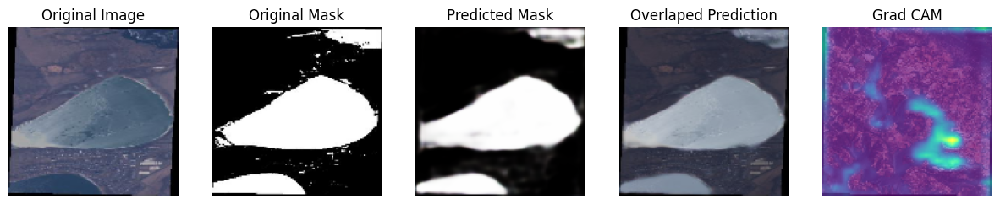

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


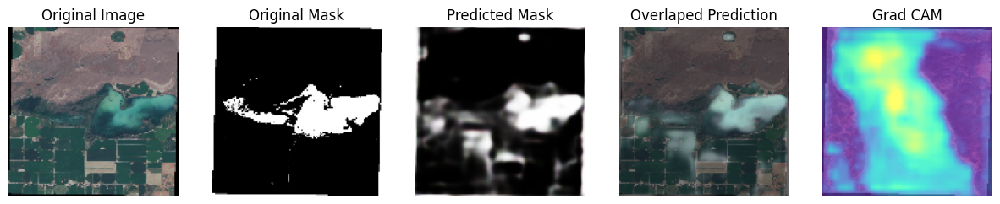

62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 231ms/step - loss: 0.0815 - val_loss: 0.3189
Epoch 31/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0793

62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 121ms/step - loss: 0.0793 - val_loss: 0.3098
Epoch 32/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0706

62/62 ━━━━━━━━━━━━━━━━━━━━ 10s 117ms/step - loss: 0.0706 - val_loss: 0.3065
Epoch 33/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 0.0774

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - loss: 0.0774 - val_loss: 0.2935
Epoch 34/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.0758

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 119ms/step - loss: 0.0758 - val_loss: 0.3103
Epoch 35/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 0.0745

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


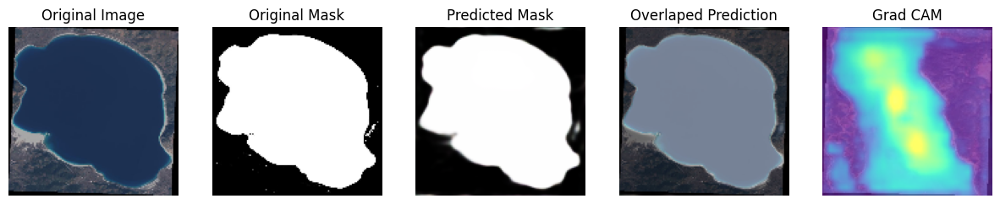

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


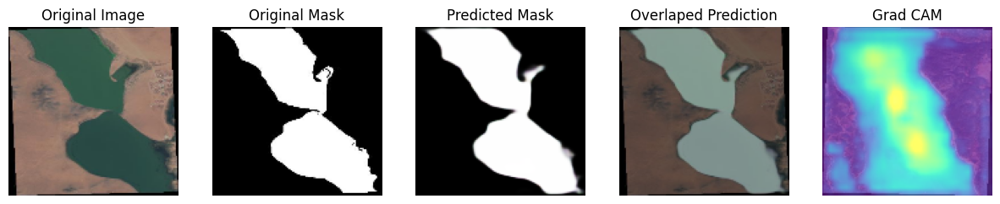

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


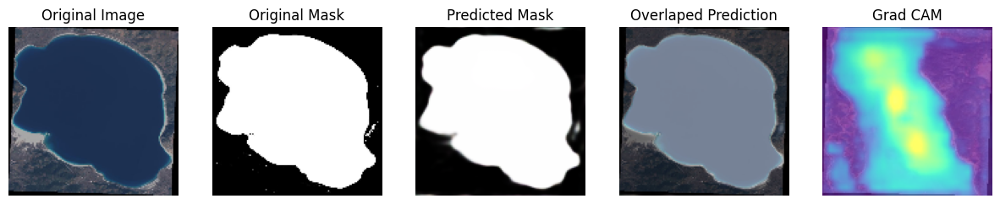

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


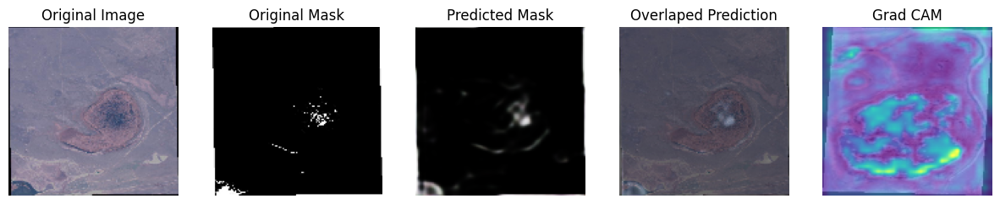

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


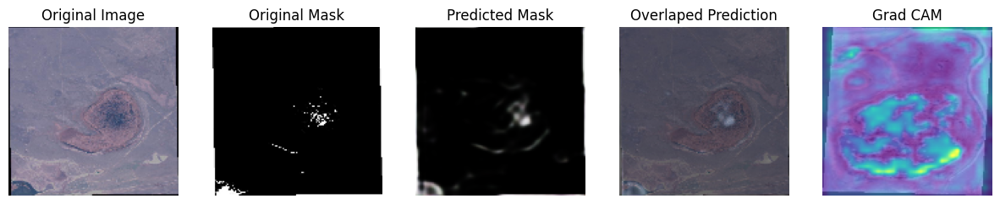

62/62 ━━━━━━━━━━━━━━━━━━━━ 17s 222ms/step - loss: 0.0745 - val_loss: 0.3331
Epoch 36/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0746

62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 117ms/step - loss: 0.0746 - val_loss: 0.2988
Epoch 37/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0734

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 116ms/step - loss: 0.0734 - val_loss: 0.3105
Epoch 38/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0742

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 121ms/step - loss: 0.0741 - val_loss: 0.3148
Epoch 39/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.0692

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 120ms/step - loss: 0.0692 - val_loss: 0.3134
Epoch 40/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0711

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


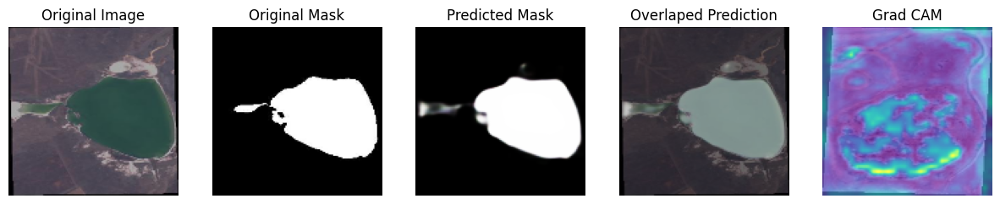

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


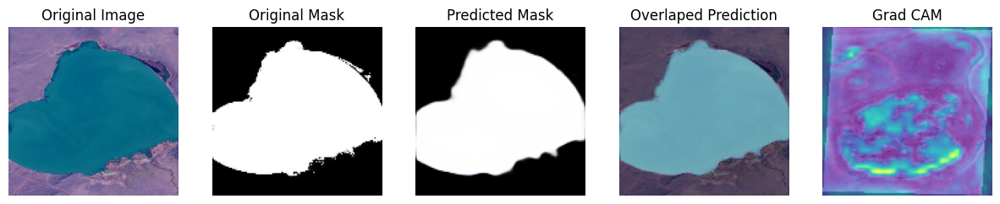

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


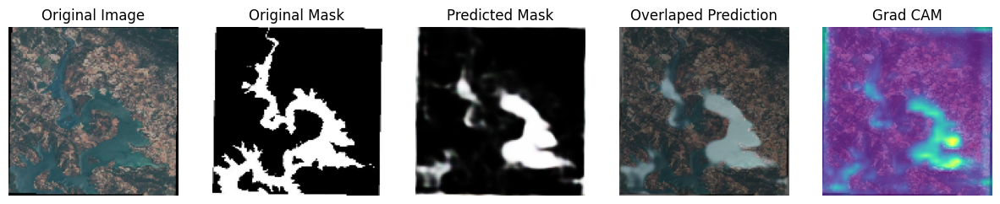

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


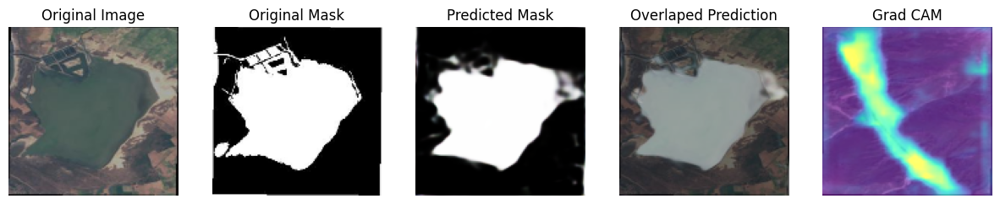

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


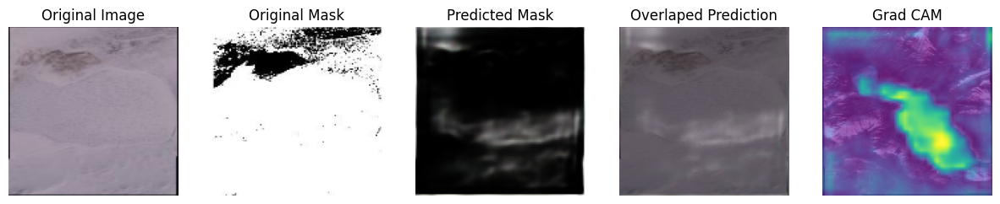

62/62 ━━━━━━━━━━━━━━━━━━━━ 17s 234ms/step - loss: 0.0711 - val_loss: 0.3330
Epoch 41/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.0737

62/62 ━━━━━━━━━━━━━━━━━━━━ 14s 122ms/step - loss: 0.0737 - val_loss: 0.3478
Epoch 42/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.0682

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 120ms/step - loss: 0.0682 - val_loss: 0.3148
Epoch 43/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0693

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 119ms/step - loss: 0.0693 - val_loss: 0.3458
Epoch 44/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.0715

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 116ms/step - loss: 0.0715 - val_loss: 0.3623
Epoch 45/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1234

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


/usr/local/lib/python3.11/dist-packages/tf_explain/utils/display.py:112: RuntimeWarning: invalid value encountered in divide
  heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())
/usr/local/lib/python3.11/dist-packages/tf_explain/utils/display.py:115: RuntimeWarning: invalid value encountered in cast
  cv2.cvtColor((heatmap * 255).astype("uint8"), cv2.COLOR_GRAY2BGR), colormap


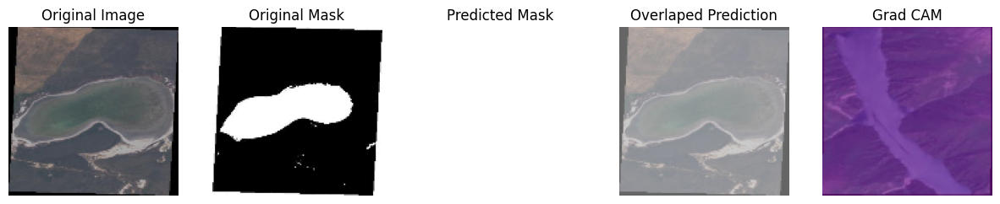

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


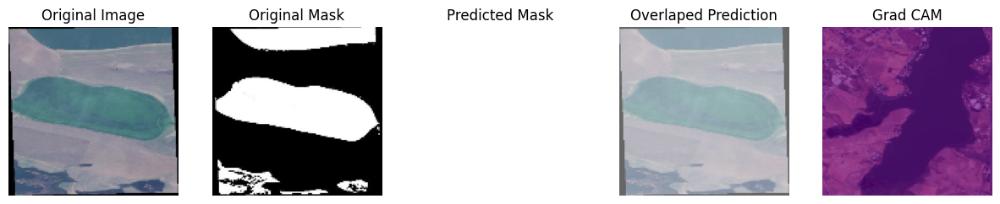

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


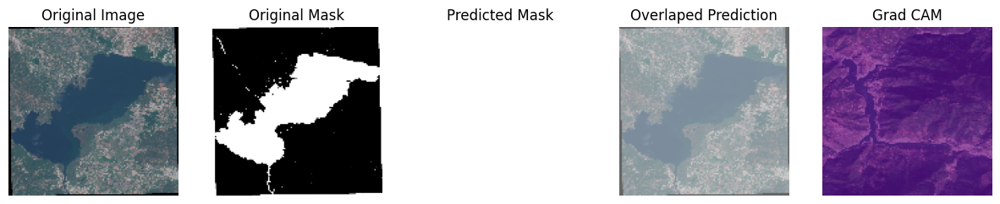

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


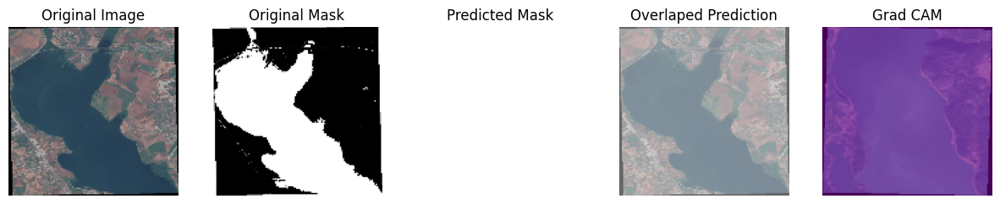

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


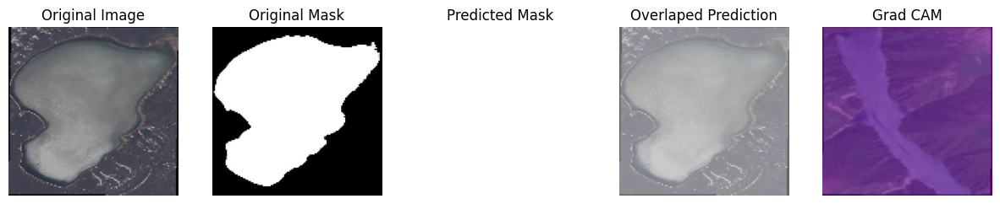

62/62 ━━━━━━━━━━━━━━━━━━━━ 15s 247ms/step - loss: 0.1251 - val_loss: 1445.2554
Epoch 46/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.5433

62/62 ━━━━━━━━━━━━━━━━━━━━ 13s 117ms/step - loss: 0.5423 - val_loss: 104.8224
Epoch 47/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - loss: 0.3938

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 120ms/step - loss: 0.3942 - val_loss: 13.9792
Epoch 48/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.3811

62/62 ━━━━━━━━━━━━━━━━━━━━ 7s 117ms/step - loss: 0.3814 - val_loss: 0.7018
Epoch 49/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.3415

62/62 ━━━━━━━━━━━━━━━━━━━━ 8s 122ms/step - loss: 0.3419 - val_loss: 0.3964
Epoch 50/50
62/62 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.3034

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


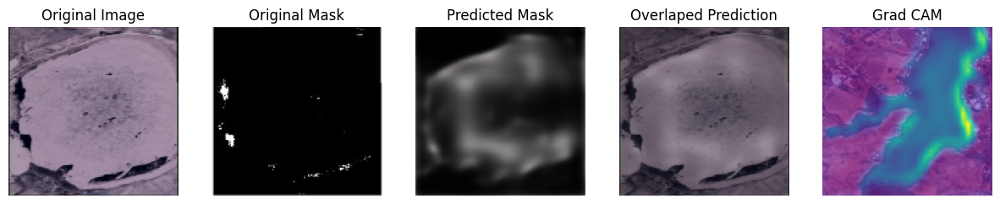

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


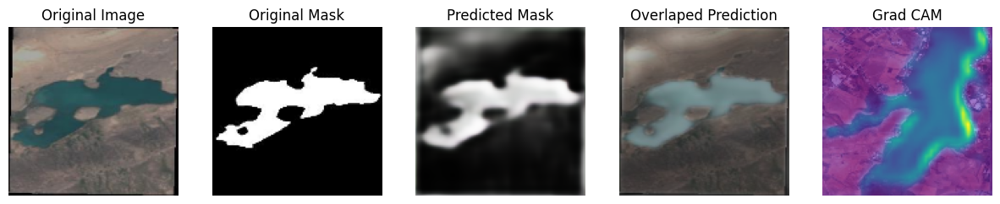

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


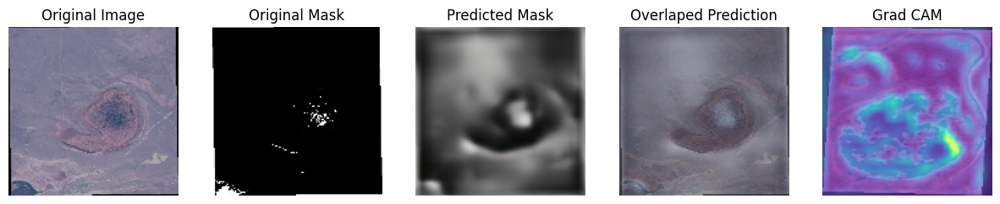

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


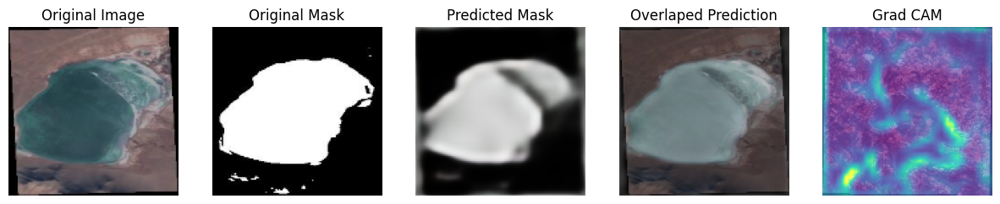

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


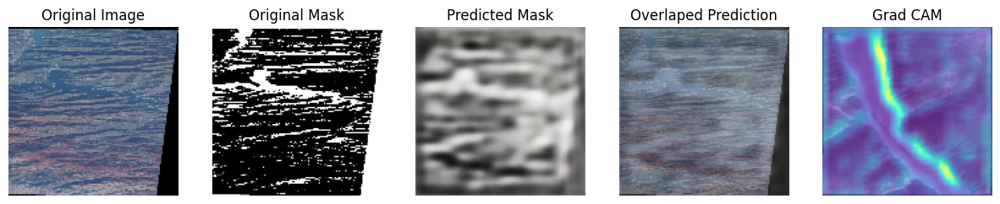

62/62 ━━━━━━━━━━━━━━━━━━━━ 15s 246ms/step - loss: 0.3036 - val_loss: 0.4397


In [14]:
# Compile Model
optimizer = tf.keras.optimizers.Adam(learning_rate=LR)
model.compile(loss='binary_crossentropy', optimizer=optimizer)

# Callback
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%5==0:
            show_images(valid_ds, model=self.model, explain=True, n_images=5, SIZE=(15,8))

# Callbacks
callbacks = [ModelCheckpoint("DeepLabV3-Plus.h5"), ShowProgress()]

# Training
model.fit(train_ds, validation_data=valid_ds, epochs=50, callbacks=callbacks)